# Homework 5a - Quintic trajectory with a H-Modquad


## Obtaining the quintic trajectory

Giving the polynomio $\gamma(t) = a_0 + a_1 t + a_2 t^2  + a_3 t^3 + a_4 t^4 + a_5 t^5$. Where $\gamma$ is the position. We can calculate its derivatives for obtaining the velocity and acceleration.

Also, obtainig the inicial and final values by

$
\begin{eqnarray}
\gamma(0) = p_0, \, \dot{\gamma}(0) = \dot{p}_0, \,
{\gamma}(t_f) =  {p}_f, \, \text{and} \,
\dot{\gamma}(t_f) =  \dot{p}_f
\end{eqnarray}
$

Where, $p_0$ is the inicial position, $\dot{p}_0$ is the inicial velocity and $\ddot{p}_0$ is the inicial acceleration, and $p_f$ is the final position, $\dot{p}_f$ is the final velocity and $\ddot{p}_f$ is the final acceleration.


#### Computing the derivatives
$
\begin{eqnarray}
\gamma(t) &=& a_0 + a_1 t + a_2 t^2  + a_3 t^3 + a_4 t^4 + a_5 t^5,\\
\dot{\gamma}(t) &=& a_1 + 2 a_2 t  + 3 a_3 t^2 + 4 a_4 t^3 + 5 a_5 t^4,\\
\ddot{\gamma}(t) &=&  2 a_2  + 6 a_3 t + 12 a_4 t^2 + 20 a_5 t^3.
\end{eqnarray}
$

#### Evaluating the final value $t=0$

$
\begin{eqnarray}
\gamma(t) &=& P_0 = a_0,\\
\dot{\gamma}(t) &=& \dot{p}_0 = a_1,\\
\ddot{\gamma}(t) &=&  \ddot{p}_0  = 2a_2.
\end{eqnarray}
$

#### Evaluating the inicial value $t=tf$

$
\begin{eqnarray}
\gamma(t_f) &=& p_f = a_0 + a_1 t_f + a_2 t_f^2 + a_3 t_f^3 + a_4 t_f^4 + a_5 t_f^5,\\
\dot{\gamma}(t_f) &=& \dot{p}_0 = a_1 + 2 a_2 t_f + 3 a_3 t_f^2 + 4 a_4 t_f^3 + 5 a_5 t_f^4,\\
\ddot{\gamma}(t_f) &=& \ddot{p}_0 = 2 a_2 + 6 a_3 t_f + 12 a_4 t_f^2 + 20 a_5 t_f^3.
\end{eqnarray}
$

#### Obtaining the polynomial coefficients

In order to get the polynomial $\gamma$ coefficients. We used Mathematica with the next code.

<pre><code>
ClearAll[r, t, dr]
r = a0 + a1 t + a2 t^2 + a3 t^3 + a4 t^4 + a5 t^5;
dr = D[r, t];
ddr = D[D[r, t], t];

eq1 = r /. {a0 -> p0, t -> 0}
eq2 = dr /. {a1 -> dp0, t -> 0}
eq3 = ddr /. {a2 -> ddp0, t -> 0}

eq4 = a0 == eq1
eq5 = a1 == eq2
eq6 = a2 == eq3
eq7 = pf == r /. {t -> tf}
eq8 = dpf == dr /. {t -> tf}
eq9 = dpf == ddr /. {t -> tf}

Simplify[Solve[
  eq4 && eq5 && eq6 && eq7 && eq8 && eq9, {a0, a1, a2, a3, a4, a5}]]
</code></pre>

Where the solution is, 

$
\begin{eqnarray}
%
a_0 &=& p_0,\\
%
a_1 &=& \dot{p}_0,\\
%
a_2 &=& 2 \ddot{p}_0,\\
%
a_3 &=& \frac{t_f \left (-12 \ddot{p}_0 t_f -12 \dot{p}_0 + \dot{p}_f (t_f - 8 ) \right) -20 p_0 + 20 p_f } { 2 t_f^3},\\
%
a_4 &=& \frac{t_f (6 \ddot{p}_0 t_f + 8 \dot{p}_0 - \dot{p}_f t_f+7 \dot{p}_f)+ 15 p_0 - 15 {pf}}{t_f^4},\\
%
a_5 &=& \frac{t_f \left(-4 \ddot{p}_0 t_f - 6 \dot{p}_0 + \dot{p}_f (t_f-6) \right)-12 p_0+12 p_f}{2 t_f^5}.
\end{eqnarray}
$


In [141]:



%pylab inline

import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt

from numpy.linalg import pinv

import matplotlib.pyplot as plt
# from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML

import matplotlib.patches as patches
    
# import matplotlib
# matplotlib.rcParams['animation.embed_limit'] = 2**128
matplotlib.rcParams.update({'font.size': 10})
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

def Rotz(Θ):
    R = array([[cos(Θ), -sin(Θ),0], [sin(Θ), cos(Θ),0],[0,0,1]])
    return R

def Roty(Θ):
    R = array([[cos(Θ), sin(Θ)], [-sin(Θ), cos(Θ)]])
    return R


def plotsim(x_log, xd_log):
    x_log = array(x_log)
    xd_log = array(xd_log)

    
#     fig, ax = plt.subplots()
    fig, ax = plt.subplots(figsize=(5, 5))
    ax.plot(x_log[:,0], x_log[:,1])
    ax.plot(xd_log[:,0], xd_log[:,1],'--r')
    ax.add_patch(patches.Rectangle((0.5, -5),2,10,edgecolor = 'black',facecolor = 'black',fill=True))
    ax.add_patch(patches.Rectangle((5, -1),2,8,edgecolor = 'black',facecolor = 'black',fill=True))
    
    xlabel('x')
    ylabel('z')
    plt.tight_layout()
    fig = plt.figure(figsize=(10,5))
    subplot(3,3,1)
    plot(time[:],x_log[:-1,0])
    plot(time[:],xd_log[:-1,0],'--r')
    xlabel('t')
    ylabel('x')  
    subplot(3,3,2)
    plot(time[:],x_log[:-1,1])
    plot(time[:],xd_log[:-1,1],'--r')
    xlabel('t')
    ylabel('z')
    subplot(3,3,3)
    plot(time[:],x_log[:-1,2])
    plot(time[:],xd_log[:-1,2],'--r')
    xlabel('t')
    ylabel('phi')  
    plt.show()
    


Populating the interactive namespace from numpy and matplotlib


## a single module with three motors 

<div>
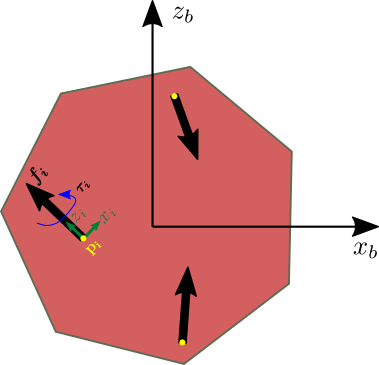
</div>

We ilustrate in the figure a single module. Where, $\boldsymbol{z}i = {}^B \boldsymbol{R}_i \boldsymbol{e}_3$ and $\boldsymbol{e}_3 = [ 0 \, 0 \, 1]^T$.

$
\begin{eqnarray}
        \boldsymbol{f}_i &=& f_i \, \boldsymbol{z}_i, \, \\
        \boldsymbol{\tau}_i &=& \left (\boldsymbol{p}_i \times \boldsymbol{z}_i + \frac{k_f}{k_m} \boldsymbol{z}_i \right) f_i
\end{eqnarray}
$

Where $\boldsymbol{p}_i$ is the position of the rotor in the body frame and $\boldsymbol{R}_i$ is the orientation of the rotor in the body frame



[[[ 8.09016994e-01 -1.00000000e+00  7.07106781e-01]
  [ 5.87785252e-01 -1.22464680e-16 -7.07106781e-01]]

 [[-5.87785252e-01  1.22464680e-16  7.07106781e-01]
  [ 8.09016994e-01 -1.00000000e+00  7.07106781e-01]]]
Rank is: 3


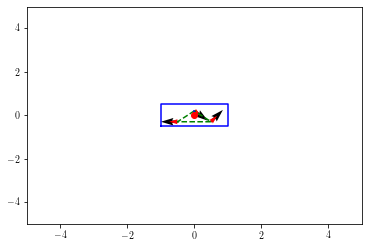

In [104]:
RotY = lambda θ: [[cos(θ), 0, sin(θ)], 
         [0, 1, 0],
         [-sin(θ), 0, cos(θ)]]

def vehicle_se2(x, z, θ, D, u=[0,0,0], ax=plt.axes()): 
#     ax.clear()
    ax.set_xlim([-5,5])
    ax.set_ylim([-5,5])
    # Design
    pxs = list(D[:,0])
    pzs = list(D[:,1])    
    αs  = copy(D[:,2])
    # Rotate
    R = RotY(θ)
    points = D[:,:2]
    points = array([np.dot(R, [px,0,pz]) for px,pz in points])
    pxs = points[:,0]
    pzs = points[:,2]
    
    
    D2 = array([(-1,-.5,0), (-1,0.5,0), (1, .5,0), (1, -.5,0)])
    pxs2 = list(D2[:,0])
    pzs2 = list(D2[:,1])
    # Rotate
    points2 = D2[:,:2]
    points2 = array([np.dot(R, [px2,0,pz2]) for px2,pz2 in points2])
    pxs2 = points2[:,0]
    pzs2 = points2[:,2]
    
    αs += θ
    # Translate
    pxs += x
    pzs += z
    pxs2 += x
    pzs2 += z
    # propellers
    e1 = [1,0,0]    
    prop_x = array([np.dot(RotY(α), e1)[0] for α in αs])
    prop_z = array([np.dot(RotY(α), e1)[2] for α in αs])
    # Plot propellers
    ax.quiver(pxs, pzs, prop_x, prop_z, scale=20)
    # control input    
    ax.quiver(pxs, pzs, u*prop_x, u*prop_z, scale=40, color='r')
    # Plot Frame           
    ax.plot(list(pxs) + [pxs[0]], list(pzs) + [pzs[0]],'--g')
    ax.plot(list(pxs2) + [pxs2[0]], list(pzs2) + [pzs2[0]],'b')
    ax.plot([x, pxs[0]], [z, pzs[0]],'b')    
    ax.plot(x,z, 'ro')  # Center of mass
#     ax.hold(True)
    

D1 = array([(0,0.2,pi/5), (-.5,-0.3,-pi), (.5, -0.3, -pi/4)])
x, z, θ = 0., 0., 0
u = 1, 1, 1 
vehicle_se2(x, z, θ, D1, u)


# D2 = array([(-0,0.5,pi/2), (-1.5,-0.3, -3*pi/4), (1.5, -0.3, 0)])
# x, z, θ = 2., 0., 0
# u = 0,0,0
# vehicle_se2(x, z, θ, D2, u)

# D = np.vstack((D1,D2))
D=D1

αs = copy(D[:,2])
co = cos(αs)
si = sin(αs)

#points

pxs = list(D[:,0])
pzs = list(D[:,1])


zi = (Roty(list(αs[:])))
print(zi)


A = array([co, si, [pzs[0]*co[0]-pxs[0]*si[0], pzs[1]*co[1]-pxs[1]*si[1], pzs[2]*co[2]-pxs[2]*si[2]]])


# print(A)
print('Rank is:', np.linalg.matrix_rank(A))



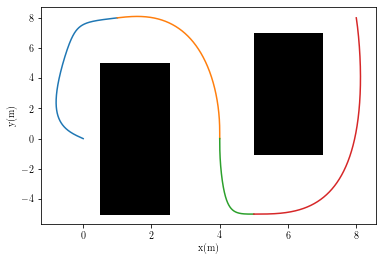

In [145]:
def quintic_trajec(p0, dp0, ddp0, pf, dpf, ddpf, tf, Δt = 0.01 ):
    t = np.linspace(0, tf, int(tf / Δt) + 1)
    a0 = p0
    a1 = dp0
    a2 = 2*ddp0
    a3 = (-20*p0 + 20*pf + tf*(-12*dp0 + dpf*(-8+tf) - 12*ddp0*tf))/(2*tf**3)
    a4 = (15*p0 - 15*pf + tf*(8*dp0 + 7*dpf + 6*ddp0*tf - dpf*tf))/(tf**4)
    a5 = (-12*p0 + 12*pf + tf*(-6*dp0 + dpf*(-6+tf) - 4*ddp0*tf))/(2*tf**5)

    r = a0 + a1*t + a2*t**2 + a3*t**3 + a4*t**4 + a5*t**5
    dr = a1 + 2*a2*t + 3*a3*t**2 + 4*a4*t**3 + 5*a5*t**4
    ddr = 2*a2 + 6*a3*t + 12*a4*t**2 + 20*a5*t**3
    
    return r, dr, ddr

def piecewise2D (Pp,Vv,Aa, T):
    r = array([[0],[0],[0]])
    dr = array([[0],[0],[0]])
    ddr = array([[0],[0],[0]])
    
    for i in range(len(Pp)-1):  
        ri, dri, ddri = quintic_trajec(Pp[i].reshape(3,1), Vv[i].reshape(3,1), Aa[i].reshape(3,1), 
                                       Pp[i+1].reshape(3,1), Vv[i+1].reshape(3,1), Aa[i+1].reshape(3,1), 
                                       Tt[i+1] - T[i])
        ax.plot(ri[0,:],ri[1,:])
        ax.add_patch(patches.Rectangle((0.5, -5),2,10,edgecolor = 'black',facecolor = 'black',fill=True))
        ax.add_patch(patches.Rectangle((5, -1),2,8,edgecolor = 'black',facecolor = 'black',fill=True))
#         ax.axis('equal')
        
        xlabel('x(m)')
        ylabel('y(m)')
        r = hstack((r,ri))
        dr = hstack((dr,dri))
        ddr = hstack((ddr,ddri))
       
    return r, dr, ddr

    
fig, ax = plt.subplots()


# Waypoints
p1 = [0.,0, -pi/2]
p2 = [1.,8, 0]
p3 = [4,0, pi/2]
p4 = [5,-5, 0]
p5 = [8,8, pi/2]

# Velocities
v1 = [-.6,0.6, 0]
v2 = [1.5,0.4, 0]
v3 = [0.,-1.5, 0]
v4 = [1.,0., 0]
v5 = [0.,0., 0]

# Acceleration
a1 = [-0.,0., 0]
a2 = [0.2,0, 0]
a3 = [0,.0, 0]
a4 = [0,0., 0]
a5 = [0,0., 0]

# Time
t1 = 0
t2 = 7
t3 = 11
t4 = 15
t5 = 25

# Convert the initial conditions to a vector form
Pp = np.vstack((p1, p2, p3, p4, p5))
Vv = np.vstack((v1, v2, v3, v4, v5))
Aa = np.vstack((a1, a2, a3, a4, a5))
Tt = [t1, t2, t3, t4, t5]

r, dr, ddr = piecewise2D (Pp,Vv,Aa, Tt)

xdp = vstack((r[0],r[1],r[2],dr[0],dr[1],dr[2],ddr[0],ddr[1],ddr[2]))



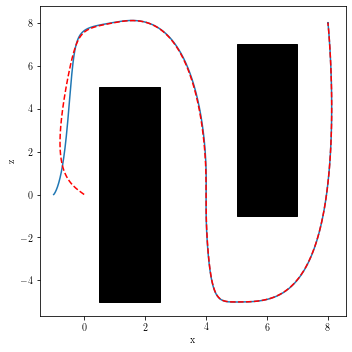

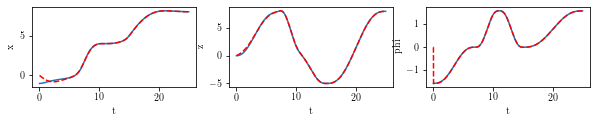

In [146]:



def trajectory(t):
#     xd = array([1,2,0.5*sin(t/2), 
#                 0,0,0.5*cos(t/2)/2])
    xd = array([5 + 5*sin(t/2), 5 + 5*cos(t/2), pi/2*cos(t/2), 
                5*cos(t/2)/2, -5*sin(t/2)/2    , -pi/2*sin(t/2)/2,
               -5*sin(t/2)/4, -5*cos(t/2)/4    , -pi/2*cos(t/2)/4])
    return xd

def control(x,xd,t):

       
    epos = array(xd[0:3] - x[0:3])
    evel = xd[3:6] - x[3:6]
     
    u = kp*epos.T + kp*evel.T + xd[6:9]
    
#     print(u)
    
    return u

def simulate(x,u,t):
    
    #desired wrench
    w = A.dot(u)
    
    Baux = np.hstack((Roty(x[2])/m,array([[0],[-g]])))
    Baux = np.vstack((Baux,array([0,0,Iyy])))    
    
    B = Baux.dot(A)
   
    uT = inv(B).dot(u + array([0,-g, 0]))
    
    a = B.dot(uT) - array([0,-g, 0])
    
    dx = concatenate((x[3:6], a[0:3]), axis=None)  
    
    x += dx * Δt
    
    return [x]



tf = 25.
Δt = 0.01    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval
g = 9.8
ℓ = 1.
d = 1

τ = -ℓ
Iyy = 1
m=1
kp = array([1,1,1])#array([1.5,1.5,2.])
kd = array([0.1,0.1,0.1])#array([0.5,0.5,0.5])

xd = zeros((1,6))

dx_0 = array([0., 0., 0.01])
x_0 = array([-1., 0., -pi/2.])

x = concatenate((x_0, dx_0/m), axis=None)
xd = xdp[:,int(0/Δt)]
u = array([0., 0., 0.])

x_log = [copy(x)]
xd_log = [copy(xd)]
u_log = [copy(u)]

for t in time:
#     xd = trajectory(t)
    xd = xdp[:,int(t/Δt)]
#     print(xd)
    u = control(x,xd,t)
    [x] = simulate(x,u,t)
    
    x_log.append(copy(x))
    xd_log.append(copy(xd))
    u_log.append(copy(u))
    
# sol = odeint(simulate, x, t, args=(m, ℓ, ))    


plotsim(x_log,xd_log)


Animation size has reached 20982360 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


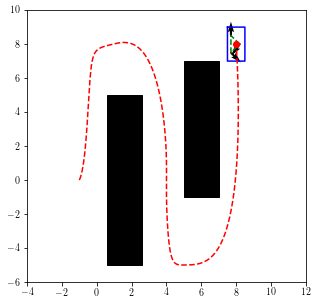

In [150]:
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML


fig, ax = plt.subplots(figsize=(5, 5))
x_log = array(x_log) 
u_log = array(u_log) 
    
def animate(t):
    ax.clear()
    ax.set_xlim([-4,12])
    ax.set_ylim([-6,10])
    
    # Path
    x, z, θ = x_log[t,0], x_log[t,1], x_log[t,2]
    u = u_log[t]
    

    # Design
    pxs = list(D[:,0])
    pzs = list(D[:,1])    
    αs  = copy(D[:,2])
    # Rotate
    R = RotY(θ)
    points = D[:,:2]
    points = array([np.dot(R, [px,0,pz]) for px,pz in points])
    pxs = points[:,0]
    pzs = points[:,2]
    
    
    D2 = array([(-1,-.5,0), (-1,0.5,0), (1, .5,0), (1, -.5,0)])
    pxs2 = list(D2[:,0])
    pzs2 = list(D2[:,1])
    # Rotate
    points2 = D2[:,:2]
    points2 = array([np.dot(R, [px2,0,pz2]) for px2,pz2 in points2])
    pxs2 = points2[:,0]
    pzs2 = points2[:,2]
    
    αs += θ
    # Translate
    pxs += x
    pzs += z
    pxs2 += x
    pzs2 += z
    # propellers
    e1 = [1,0,0]    
    prop_x = array([np.dot(RotY(α), e1)[0] for α in αs])
    prop_z = array([np.dot(RotY(α), e1)[2] for α in αs])
    # Plot propellers
    ax.quiver(pxs, pzs, prop_x, prop_z, scale=20)
    # control input    
    ax.quiver(pxs, pzs, u*prop_x, u*prop_z, scale=40, color='r')
    # Plot Frame           
    ax.plot(list(pxs) + [pxs[0]], list(pzs) + [pzs[0]],'--g')
    ax.plot(list(pxs2) + [pxs2[0]], list(pzs2) + [pzs2[0]],'b')
    ax.plot([x, pxs[0]], [z, pzs[0]],'b')    
    ax.plot(x,z, 'ro')  # Center of mass
    ax.add_patch(patches.Rectangle((0.6, -5),2,10,edgecolor = 'black',facecolor = 'black',fill=True))
    ax.add_patch(patches.Rectangle((5, -1),2,8,edgecolor = 'black',facecolor = 'black',fill=True))

    
    
    
    plot(x_log[:,0], x_log[:,1], '--r')
    
    

anim = matplotlib.animation.FuncAnimation(fig, animate, frames=len(time), interval=1)


HTML(anim.to_jshtml())
# display(HTML(anim.to_jshtml()))